## SpaGFT Tutorial：Visium Human Lymph Node

### Outline
1. Import packages
<br />
<br />
2. Load data
<br />
<br />
3. QC and preprocessing
<br />
<br />
4. Function: identify spatially variable genes
<br />
<br />
5. Function: gene expression enhancement
<br />
<br />
6. Function: characterize tissue modules

The installation steps can be found [here](https://github.com/jxLiu-bio/SpaGFT). SpaGFT is a python package to analyze spatial transcriptomics data based on graph Fourier transform. To install SpaGFT, the python version is required to be >= 3.7. You can check your python version by:

In [1]:
import platform
platform.python_version()

'3.8.0'

### 1. Import packages

In [2]:
import SpaGFT as spg
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os


sc.settings.verbosity = 3
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.5 scipy==1.8.0 pandas==1.4.2 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.10 louvain==0.7.1 pynndescent==0.5.7


First, define the folder to save the results which are generated from the following analysis:

In [3]:
results_folder = './results/lymph_nodes_analysis/'
if not os.path.exists(results_folder):
    os.makedirs(results_folder)

### 2. Load data

In this tutorial, we use a publicly available Visium dataset of the human lymph node. The dataset can be downloaded easily through ```Scanpy```. Two key elements are essential for running SpaGFT, including the raw gene counts matrix and spatial coordinates of spots. In addition, these two elements should be integrated into an ```anndata``` object, which is a frequently-used python object.

In [4]:
# Load data
adata = sc.datasets.visium_sge(sample_id="V1_Human_Lymph_Node")
adata.var_names_make_unique()
# Add raw to anndata object
adata.raw = adata

reading /home/frank/Desktop/SpaGFT_scripts/SpaGFT_packages/data/V1_Human_Lymph_Node/filtered_feature_bc_matrix.h5
 (0:00:00)


Users can create other anndata objects for their datasets. Note that the raw count matrix should be found in adata.X, and the spatial coordinates of all spots should be found in ```adata.obs``` or ```adata.obsm```. Users can use other functions provided by scanpy to create the anndata object. For example, you can read Visium datasets through
```Python
sc.read_visium()
```
Alternatively, users can also create the anndata object using the raw count matrix and spatial coordinates of spots in a direct way:
```Python
count_mtx = pd.read_csv(PATH_TO_COUNT_MATRIX)
coord_mtx = pd.read_csv(PATH_TO_COORDINATE_MATRIX)
count_mtx.iloc[:5, :5]
coord_mtx.iloc[:5, :5]
# create the anndata object
adata = sc.AnnData(count_mtx)
adata.obs.loc[:, ['x', 'y']] = coord_mtx
adata.var_names_make_unique()
adata.raw = adata
```
More approaches to load datasets and details about anndata object can be found at [Scanpy](https://scanpy.readthedocs.io/en/stable/api.html#reading)


### 3. QC and preprocessing
We perform some basic filtering of genes and normalize Visium counts data with the ```normalize_total``` method from Scanpy followed by log-transform.

In [5]:
# QC
sc.pp.filter_genes(adata, min_cells=10)
# Normalization
sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)

filtered out 16788 genes that are detected in less than 10 cells
normalizing counts per cell
    finished (0:00:00)


### 4. Function: identify spatially variable genes

Spatially variable genes (SVGs) are genes that exhibit specific spatial patterns. SpaGFT will transform the gene expression signal from the spatial/vertex domain to the frequency/spectral domain and identify SVGs in the frequency domain. There are three key parameters:
+ *ratio_neighbors*, which determines the neighbors of a spot when constructing a KNN graph. In SpaGFT, $K=\mbox{ratio_neighbors} \times \sqrt{n}/2$, where $n$ represents the number of spots.

+ *ratio_low_freq*, which determines the number of low-frequency Fourier modes (FM) used to describe the gene expression signals. In SpaGFT, the top $\mbox{ratio_low_freq} \times \sqrt{n}$ low-frequency Fourier modes will be utilized to describe gene expression signals, where $n$ represents the number of spots.

+ *ratio_high_freq*, which determines the number of high-frequency Fourier modes used, as the contrast to measure how high the contributions of low-frequency to recover the signals of genes. In SpaGFT, the top $\mbox{ratio_high_freq} \times \sqrt{n}$ high-frequency Fourier modes will be utilized, where $n$ represents the number of spots.

In addition, SpaGFT also provides the built-in method to determine *ratio_low_freq* and *ratio_high_freq* automatically.

In [6]:
# determine the number of low-frequency FMs and high-frequency FMs
(ratio_low, ratio_high) = spg.gft.determine_frequency_ratio(adata,
                                                            ratio_neighbors=1)

Obatain the Laplacian matrix


In [7]:
# calculation
gene_df = spg.detect_svg(adata,
                         spatial_info=['array_row', 'array_col'],
                         ratio_low_freq=ratio_low,
                         ratio_high_freq=ratio_high,
                         ratio_neighbors=1,
                         filter_peaks=True,
                         S=6)
# extract spaitally variable genes
svg_list = gene_df[gene_df.cutoff_gft_score][gene_df.qvalue < 0.05].index.tolist()
print("The number of SVGs: ", len(svg_list))
# the top 20 SVGs
print(svg_list[:20])

The precalculated low-frequency FMs are USED
The precalculated high-frequency FMs are USED
Graph Fourier Transform finished!
SVG ranking could be found in adata.var['svg_rank']
The spatially variable genes judged by gft_score could be found 
          in adata.var['cutoff_gft_score']
Gene signals in frequency domain when detect SVGs could be found
          in adata.varm['freq_domain_svg']
The number of SVGs:  1346
['IFI44L', 'ISG15', 'MT-CO2', 'IFI6', 'MX1', 'MT-CO1', 'EEF1A1', 'CXCL12', 'TMSB4X', 'ACTG1', 'IFI44', 'IFIT1', 'CCL2', 'GAPDH', 'MT-CO3', 'RPL32', 'OASL', 'RPS2', 'SFRP2', 'ACTB']


We can use the visualization function provided by scanpy or our built-in function to visualize gene expression patterns.

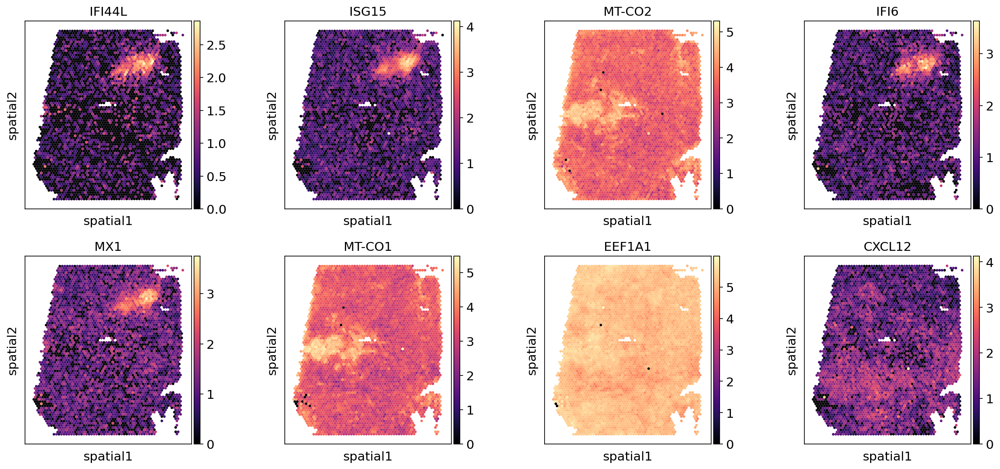

In [8]:
sc.pl.spatial(adata, color=svg_list[:8], img_key=None, size=1.6, cmap='magma', use_raw=False)

One of the characteristics of SpaGFT is that it can obtain new representations for genes in the frequency domain. In the above genes' normalized frequency signals can be found in ```adata.varm['freq_domain_svg']``` and visualized by

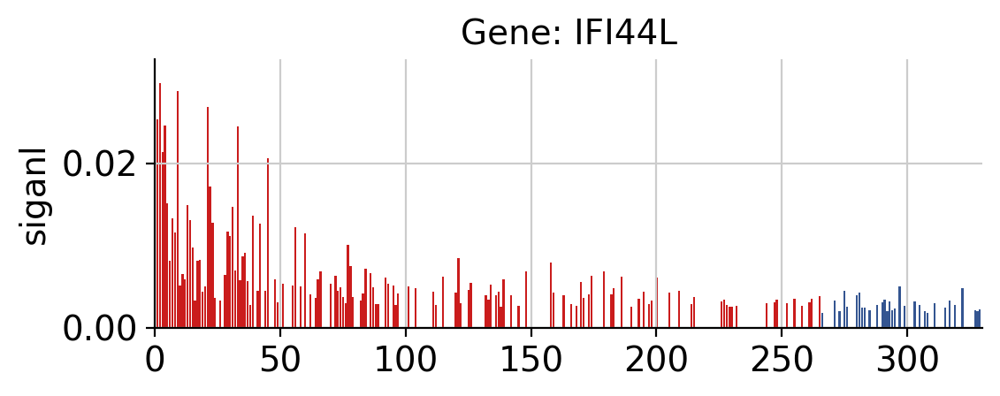

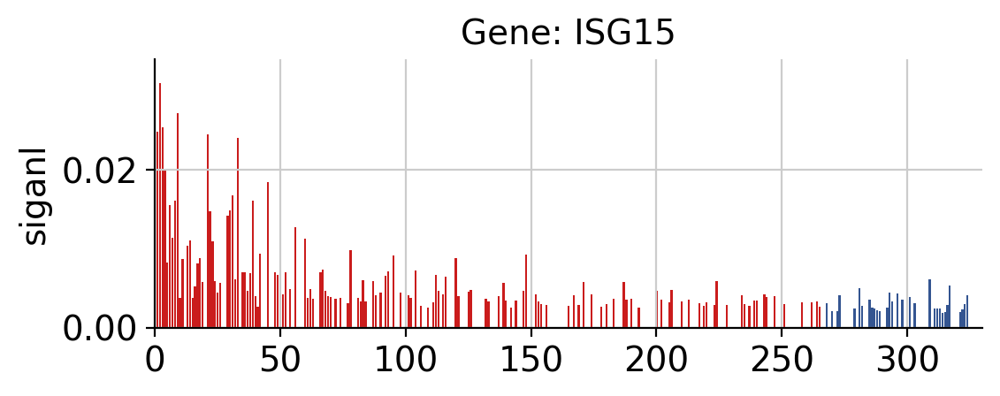

In [9]:
spg.plot.gene_freq_signal(adata, gene=svg_list[0])
spg.plot.gene_freq_signal(adata, gene=svg_list[1])

where the red parts correspond to low-frequency signals while the bule parts correspond to high-frequency signals. 
In addition, we can also separate SVGs and non-SVGs in the frequency domain. By projecting the frequency domain to 2-dimensional space by UMAP, we can verify this easily:

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:17)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)
The umap coordinates of genes when identify SVGs could be found in 
          adata.varm['freq_umap_svg']


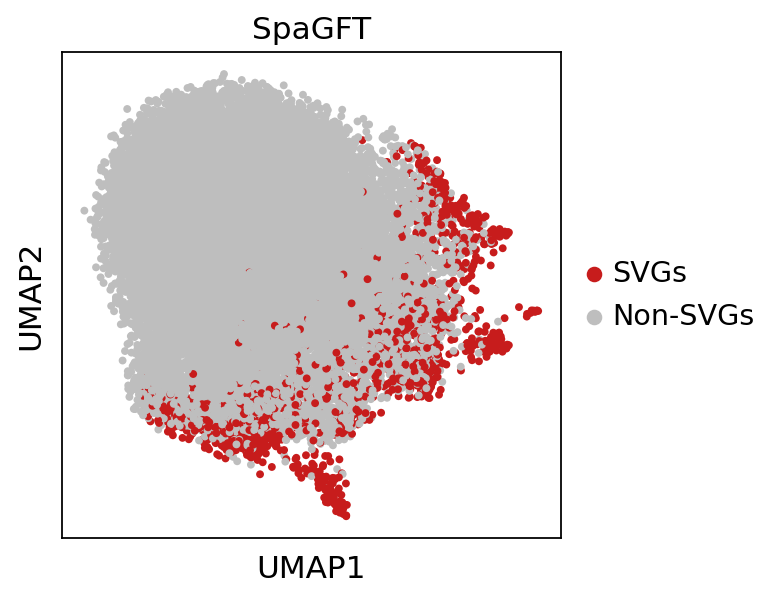

In [10]:
# gene umap
spg.plot.gene_signal_umap(adata, svg_list, size=50)
svg_umap_df = pd.DataFrame(adata.varm['freq_umap_svg'],
                           index=adata.var_names,
                           columns=['UMAP_1', 'UMAP_2'])

### 5. Function: gene expression enhancement

SRT expression data suffers from high noise typically, which will affect the credibility of analytical results. SpaGFT adapts a low-pass filter to process signals in the frequency domain and performs inverse GFT to obtain enhanced signals.
Note that this step is time-consuming, and it will take several minutes for Visium datasets.

In [11]:
# copy from the original dataset
new_adata = adata.copy()
new_adata = spg.low_pass_enhancement(new_adata,
                                     inplace=True,
                                     c=0.001,
                                     ratio_low_freq=15)

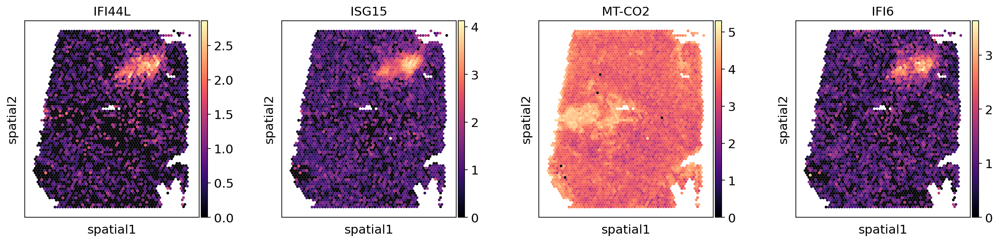

In [12]:
# Before enhancement
sc.pl.spatial(adata, color=svg_list[:4], img_key=None, size=1.6, cmap='magma', use_raw=False)

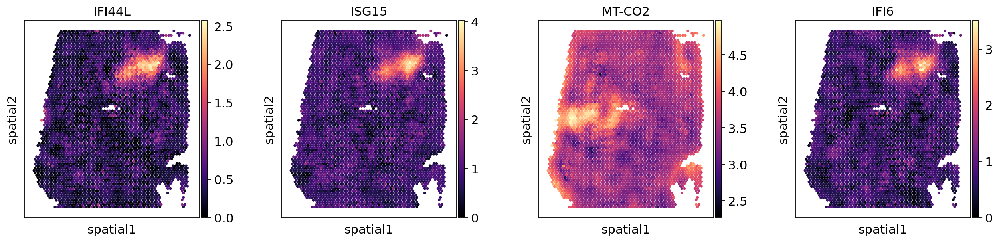

In [13]:
# After enhancement
sc.pl.spatial(new_adata, color=svg_list[:4], img_key=None, size=1.6, cmap='magma', use_raw=False)

In the following, we will use the enhanced gene expression matrix for analysis.

### 6. Function: identify tissue modules

In [14]:
# identify tissue modules (TM)
gene_df, new_adata = spg.identify_tissue_module(new_adata, 
                                     svg_list=svg_list,
                                     ratio_fms=ratio_low,
                                     resolution=(0.5, 1.5, 0.1),
                                     ratio_neighbors=2,
                                     n_neighbors=15)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 7 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
resolution: 0.500;  score: 0.1675
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 7 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
resolution: 0.600;  score: 0.1675
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 7 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
resolution: 0.700;  score: 0.1671
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 7 clusters and added
    'louvain', the cluster labels 

This step will identify gene groups and the results can be found at ```adata.var['tissue_module']```. Besides, the tissue module information can be found at ```adata.obsm['tm_binary']```.

In [15]:
# the genes which support corresponding tissue modules
gene_df.to_csv(os.path.join(results_folder,
                           'Lymphnode_gene_information_results.csv'))
gene_df.iloc[:8, :]

,gene_ids,feature_types,genome,n_cells,gft_score,svg_rank,cutoff_gft_score,pvalue,qvalue,tissue_module
IFI44L,ENSG00000137959,Gene Expression,GRCh38,1882,4.973869,1,True,5.813716e-80,6.207737e-78,8
ISG15,ENSG00000187608,Gene Expression,GRCh38,3054,4.877024,2,True,2.888858e-55,1.733219e-53,8
MT-CO2,ENSG00000198712,Gene Expression,GRCh38,4030,4.615628,3,True,2.816433e-100,5.385450e-98,6
IFI6,ENSG00000126709,Gene Expression,GRCh38,2681,4.561138,4,True,9.051660e-80,9.630435e-78,8
MX1,ENSG00000157601,Gene Expression,GRCh38,3326,4.508339,5,True,1.832998e-49,9.583907e-48,8
MT-CO1,ENSG00000198804,Gene Expression,GRCh38,4024,4.460884,6,True,1.478062e-98,2.671179e-96,6
EEF1A1,ENSG00000156508,Gene Expression,GRCh38,4031,4.407185,7,True,1.478062e-98,2.671179e-96,6
CXCL12,ENSG00000107562,Gene Expression,GRCh38,3571,4.350340,8,True,8.236343e-67,6.383198e-65,4


We can visualize the clustering results by UMAP in this way:

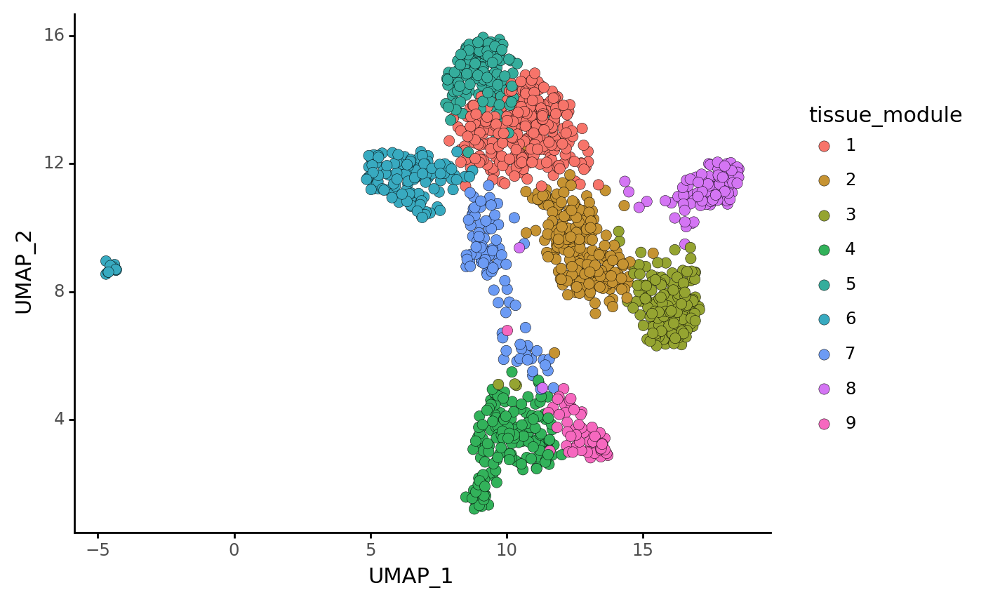

In [16]:
spg.plot.scatter_umap_clustering(new_adata, svg_list)

There are 9 tissue modules via our computation. In the following, we will visualize the results. To begin with, obtain tissue modules information:

In [17]:
# The tissue module information can be obtained by
tm_binary_df = new_adata.obsm['tm_binary']
tm_binary_df.to_csv(os.path.join(results_folder,
                           'Lymphnode_tissue_module_information_results.csv'))
tm_binary_df.iloc[:10, :5]

,tm_1,tm_2,tm_3,tm_4,tm_5
AAACAAGTATCTCCCA-1,0,1,0,1,0
AAACAATCTACTAGCA-1,1,1,1,0,0
AAACACCAATAACTGC-1,1,1,0,1,1
AAACAGAGCGACTCCT-1,1,1,0,0,1
AAACAGCTTTCAGAAG-1,0,1,0,0,0
AAACAGGGTCTATATT-1,1,1,0,1,0
AAACAGTGTTCCTGGG-1,1,1,1,1,0
AAACATTTCCCGGATT-1,0,0,0,1,0
AAACCCGAACGAAATC-1,0,0,0,1,0
AAACCGGGTAGGTACC-1,0,1,0,1,0


And we can visualize found tissue module by

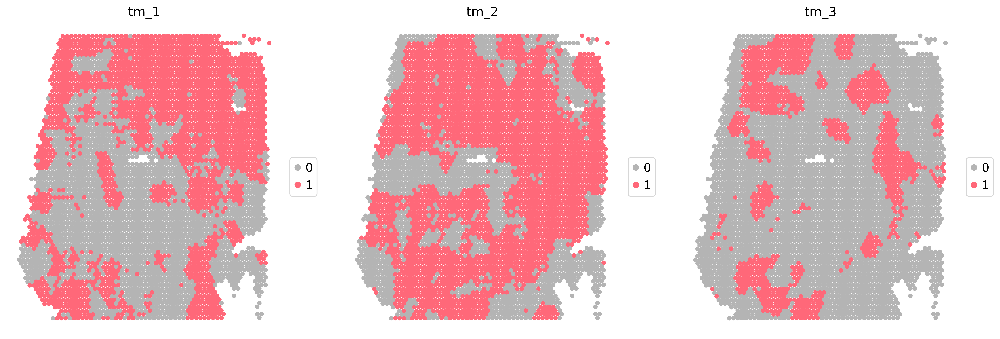

In [18]:
# plot tms
spg.plot.scatter_tm(new_adata, 
                    tm=['tm_1', 'tm_2', 'tm_3'],
                    spatial_info='spatial',
                    size=15)

Specifically, we can also visualize the tissue module and genes that support this tissue module. In the following, we will explore a specific tissue module, tm_1, which mainly locates in T cell zones.

In [19]:
# plot tm's spatial map and corresponding genes
spg.plot.scatter_tm_gene(new_adata,
                         tm="tm_3",
                         gene=gene_df.loc[gene_df.tissue_module=='3', :].index[:3],
                         spatial_info='spatial',
                         size=13)

A group of genes that support a tissue module has similar spatial patterns and we can perform functional enrichment analysis to explore underlying biological processes under this pattern.

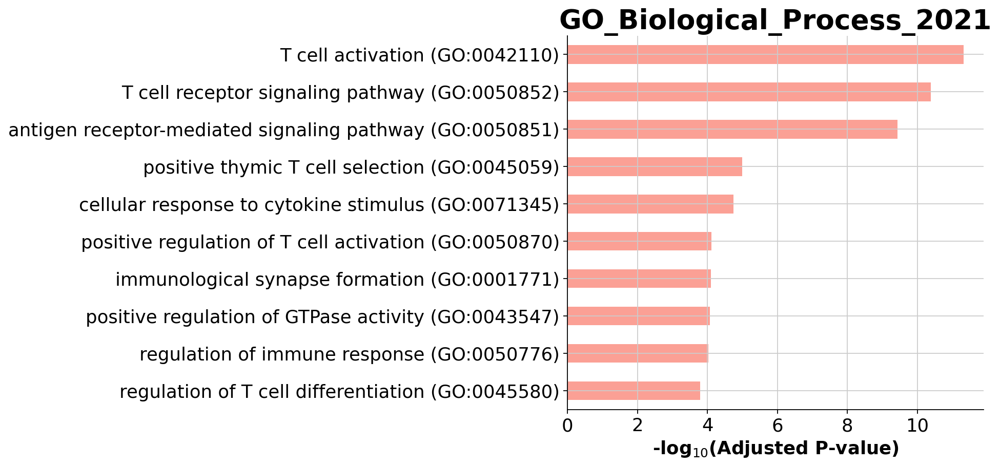

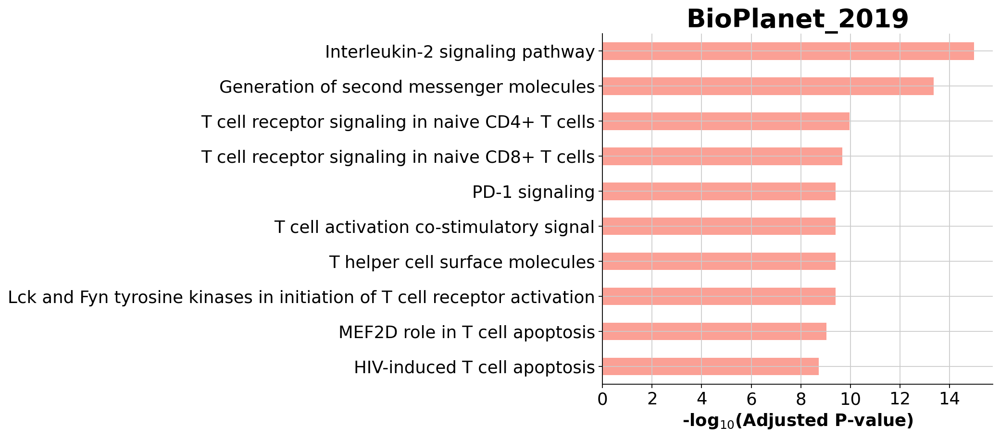

In [20]:
# GO enrichment analysis
import gseapy as gp
tm_gene_list = gene_df[gene_df.tissue_module == '3'].index.tolist()
enr = gp.enrichr(gene_list=tm_gene_list,
                  gene_sets=['BioPlanet_2019','GO_Biological_Process_2021',
                            'ChEA_2016'],
                  organism='Human',
                  description='Tissue_module',
                  outdir='test/enrichr_kegg',
                  no_plot=False,
                  cutoff=0.5 # test dataset, use lower value from range(0,1)
                )
enr_results = enr.results
from gseapy.plot import barplot, dotplot
barplot(enr.results[enr.results.Gene_set=='GO_Biological_Process_2021'],
        title='GO_Biological_Process_2021')
barplot(enr.results[enr.results.Gene_set=='BioPlanet_2019'],
        title='BioPlanet_2019')

According to the GO analysis, most enriched biological processes are related to T-cell activities. 
We can also merge the above results to generate a tissue module id card. Limited by resolutions of SRT techniques, most SRT techniques can not achieve single-cell resolution. Luckily, up to now, many tools have been developed to integrate information from scRNA-seq and SRT to obtain the spatial distributions of each cell type. Here, we use the deconvolution results from [cell2location](https://cell2location.readthedocs.io/en/latest/index.html).

In [21]:
# load normalized deconvolution resutls from cell2location
decon_results = pd.read_csv("./data/lymphnode_cell2location_results.csv",
                           index_col=0)
decon_results.iloc[:10, :5]

,q05cell_abundance_w_sf_B_Cycling,q05cell_abundance_w_sf_B_GC_DZ,q05cell_abundance_w_sf_B_GC_LZ,q05cell_abundance_w_sf_B_GC_prePB,q05cell_abundance_w_sf_B_IFN
spot,,,,,
AAACAAGTATCTCCCA-1,0.016891,0.007971,0.010410,0.001264,0.017617
AAACAATCTACTAGCA-1,0.017105,0.001437,0.001064,0.005795,0.008414
AAACACCAATAACTGC-1,0.018387,0.004278,0.010018,0.002180,0.014008
AAACAGAGCGACTCCT-1,0.025565,0.003065,0.002487,0.000469,0.508714
AAACAGCTTTCAGAAG-1,0.005364,0.005669,0.005416,0.001415,0.028294
AAACAGGGTCTATATT-1,0.021618,0.008096,0.028529,0.006210,0.028004
AAACAGTGTTCCTGGG-1,0.004549,0.002327,0.002818,0.002276,0.010794
AAACATTTCCCGGATT-1,0.010670,0.004746,0.002608,0.001290,0.013002
AAACCCGAACGAAATC-1,0.000945,0.004698,0.018770,0.002800,0.020117


In [22]:
# add deconcolutions to anndata object
new_adata.obsm['cell_type_proportion'] = decon_results

Now, we show the details of tissue module 3

In [23]:
# plot the TM ID-Card
spg.plot.draw_tissue_module_id_card(adata=new_adata,
                                    svg_list=svg_list,
                                    tm='3',
                                    spatial_info='spatial',
                                    deconvolution_key='cell_type_proportion')